# GG4527- Urban Analytics: A Toolkit for Sustainable Urban Development Assignment 2
## Lab 6: Geodemographics

-----


### Challenge 1

The main aim of this challenge is to use geodemographic classification to help  retail business on where the best location for a store is within the city of Edinburgh. This is done by using the output areas to understand certain neighbourhoods within the city that will reflect a certain lifestyle and therefore shopping habbits in the city. By doing this there will be greater understanding of these differences which can help retailers and planners make more informed decisions about where to locate services such as supermarkets, cafés, gyms, or retail outlets. 

In [32]:
# Prepping data

import pandas as pd
import os

csv_directory = "/Users/Lynsey/Documents/UA_GG4257/UA Repo/Week_6/data"
# We need a list of all CSV files in the folder
csv_files = [file for file in os.listdir(csv_directory) if file.endswith(".csv")]

# An empty DataFrame to store the merged data
merged_data = pd.DataFrame()

# Loop through each CSV file
for csv_file in csv_files:
    csv_path = os.path.join(csv_directory, csv_file) # We create a consistent path
    df_csv = pd.read_csv(csv_path, low_memory=False) #read each file
    # Concatenate/Merge all columns, there is a pitfall here, you will get a duplicate oa_code from all csv files.
    merged_data = pd.concat([merged_data, df_csv], axis=1)

# Save the merged dataset. You might want to do some pre-processing.
merged_data.to_csv("/Users/Lynsey/Documents/UA_GG4257/UA_Assignment_2/merged_census_data.csv", index=False)
# Be aware of the mixted dtype you are importing we unfortunatly have to deal with that later.
# eventually you can avoid this to define the dtype on import method.

In [33]:
import geopandas as gpd

oa_shapefile = gpd.read_file("/Users/Lynsey/Documents/UA_GG4257/UA_Assignment_2/OutputArea2011_MHW.shp")

# reading the oa of scotland that can then be filtered down to edi

In [34]:
print(oa_shapefile.columns)
oa_shapefile.head()

# the coucil code for edi is S12000036
# as confirmed by https://statistics.gov.scot/atlas/resource?uri=http%3A%2F%2Fstatistics.gov.scot%2Fid%2Fstatistical-geography%2FS12000036

Index(['OBJECTID', 'code', 'HHcount', 'Popcount', 'council', 'sqkm', 'hect',
       'masterpc', 'easting', 'northing', 'SHAPE_1_Le', 'SHAPE_1_Ar',
       'DataZone', 'geometry'],
      dtype='object')


,OBJECTID,code,HHcount,Popcount,council,sqkm,hect,masterpc,easting,northing,SHAPE_1_Le,SHAPE_1_Ar,DataZone,geometry
0,1,S00089001,55,115,S12000033,0.029184,2.918398,AB11 7XY,393374,805012,929.786180,29183.980141,S01006594,"POLYGON ((393393.000 805102.000, 393384.000 80..."
1,2,S00090016,50,100,S12000033,0.017122,1.712225,AB16 7SX,389779,808556,745.621044,17122.247009,S01006720,"POLYGON ((389796.000 808485.001, 389817.000 80..."
2,3,S00089741,45,109,S12000033,0.045336,4.533582,AB15 4AH,391312,805970,1156.172057,45335.819961,S01006572,"POLYGON ((391410.771 806073.119, 391383.319 80..."
3,4,S00088978,33,60,S12000033,0.033488,3.348824,AB10 1SB,393473,806017,1173.627495,33488.237428,S01006585,"POLYGON ((393596.593 806042.095, 393651.000 80..."
4,5,S00090442,64,97,S12000033,0.012945,1.294538,AB24 1TA,394564,808271,615.199658,12945.377768,S01006667,"POLYGON ((394659.000 808248.000, 394611.964 80..."


In [35]:
edinburgh_oa = oa_shapefile[oa_shapefile["council"] == "S12000036"]


In [36]:
print(edinburgh_oa.columns)
print(merged_data.columns)

# shows that oa code is under different names 

Index(['OBJECTID', 'code', 'HHcount', 'Popcount', 'council', 'sqkm', 'hect',
       'masterpc', 'easting', 'northing', 'SHAPE_1_Le', 'SHAPE_1_Ar',
       'DataZone', 'geometry'],
      dtype='object')
Index(['oa_code', 'All people aged 16 and over',
       'All people aged 16 and over: No qualifications',
       'All people aged 16 and over: Level 1',
       'All people aged 16 and over: Level 2',
       'All people aged 16 and over: Level 3',
       'All people aged 16 and over: Level 4 and above', 'oa_code',
       'All people', '0 to 4',
       ...
       'I. Accommodation and food service activities',
       'J. Information and communication',
       'K. Financial and insurance activities', 'L. Real estate activities',
       'M. Professional scientific and technical activities',
       'N. Administrative and support service activities',
       'O. Public administration and defence compulsory social security',
       'P. Education', 'Q. Human health and social work activities',
   

In [37]:
edinburgh_oa = edinburgh_oa.rename(columns={"code": "oa_code"}) # renaming the oa codes to the same name to allow merge

edi_merg = edinburgh_oa.merge(merged_data, on="oa_code")

In [39]:
print(merged_data.columns[merged_data.columns.duplicated()]) # shows duplicates

Index(['oa_code', 'oa_code', 'All people', 'oa_code',
       'All people aged 16 and over', 'oa_code', 'oa_code', 'oa_code',
       'All people', 'oa_code', 'oa_code', 'All people', 'oa_code'],
      dtype='object')


In [40]:
merged_data = merged_data.loc[:, ~merged_data.columns.duplicated()] # removing duplicates for merge


In [41]:
print(merged_data.columns[merged_data.columns.duplicated()])  # should be empty


Index([], dtype='object')


In [42]:
edi_merg = edinburgh_oa.merge(merged_data, on="oa_code") # try merging again

# data is preped and ready to go

In [44]:
edi_merg.head()

,OBJECTID,oa_code,HHcount,Popcount,council,sqkm,hect,masterpc,easting,northing,...,I. Accommodation and food service activities,J. Information and communication,K. Financial and insurance activities,L. Real estate activities,M. Professional scientific and technical activities,N. Administrative and support service activities,O. Public administration and defence compulsory social security,P. Education,Q. Human health and social work activities,R S T U. Other
0,7307,S00104290,35,80,S12000036,0.005849,0.584871,EH6 8AJ,327509,675739,...,7,0,4,0,3,3,1,5,7,5
1,7308,S00105247,50,134,S12000036,0.015458,1.545845,EH11 3UN,319980,671252,...,9,0,4,0,2,3,3,2,9,3
2,7309,S00107429,45,72,S12000036,0.012086,1.208595,EH14 1DD,322954,670960,...,0,3,3,1,2,0,2,2,3,4
3,7310,S00105740,45,104,S12000036,0.372084,37.208371,EH14 1DN,322537,669850,...,0,1,5,0,5,1,1,6,9,5
4,7311,S00105450,46,87,S12000036,0.021571,2.157070,EH12 6AN,323001,673215,...,3,3,13,1,8,1,5,3,8,4


## DEA

The areas that I am going to explore is age, employment, health, housing and mobility. I have decided on these outcomes as age will highlight which neighbourhoods have an older generation (this may require more stores such as pharmacys) and which neighbourhoods have a younger demographic which could suggest more gyms or social businesses. Employment levels will show show areas that have greater spending power and areas that are more deprived. Health will show what areas need an increase in NHS services..... 

In [48]:
list(edi_merg.columns)


['OBJECTID',
 'oa_code',
 'HHcount',
 'Popcount',
 'council',
 'sqkm',
 'hect',
 'masterpc',
 'easting',
 'northing',
 'SHAPE_1_Le',
 'SHAPE_1_Ar',
 'DataZone',
 'geometry',
 'All people aged 16 and over',
 'All people aged 16 and over: No qualifications',
 'All people aged 16 and over: Level 1',
 'All people aged 16 and over: Level 2',
 'All people aged 16 and over: Level 3',
 'All people aged 16 and over: Level 4 and above',
 'All people',
 '0 to 4',
 '5 to 7',
 '8 to 9',
 '10 to 14',
 '15',
 '16 to 17',
 '18 to 19',
 '20 to 24',
 '25 to 29',
 '30 to 44',
 '45 to 59',
 '60 to 64',
 '65 to 74',
 '75 to 84',
 '85 to 89',
 '90 and over',
 'Mean age',
 'Median age',
 'Church of Scotland',
 'Roman Catholic',
 'Other Christian',
 'Buddhist',
 'Hindu',
 'Jewish',
 'Muslim',
 'Sikh',
 'Other religion',
 'No religion',
 'Religion not stated',
 'Single (never married or never registered a same-sex civil partnership)',
 'Married',
 'In a registered same-sex civil partnership',
 'Separated (but 

In [55]:
# summary statistics
edi_merg['20 to 24'].describe()

count     4322
unique     105
top          5
freq       393
Name: 20 to 24, dtype: object

In [58]:
edi_merg['75 to 84'].describe()

count     4322
unique      41
top          -
freq       536
Name: 75 to 84, dtype: object

In [57]:
edi_merg['Economically active: Employee: Full-time'].describe()

count     4322
unique      92
top         33
freq       141
Name: Economically active: Employee: Full-time, dtype: object

In [59]:
edi_merg['Economically active: Unemployed'].describe()

count     4322
unique      24
top          2
freq       809
Name: Economically active: Unemployed, dtype: object

In [60]:
edi_merg['Very bad health'].describe()

count     4322
unique      18
top          -
freq      2016
Name: Very bad health, dtype: object

In [61]:
edi_merg['Very good health'].describe()

count     4322
unique     175
top         50
freq        86
Name: Very good health, dtype: object

In [62]:
edi_merg['All people aged 16 and over: No qualifications'].describe()

count     4322
unique      78
top          4
freq       236
Name: All people aged 16 and over: No qualifications, dtype: object

In [78]:
edi_merg['One family only: Married or same-sex civil partnership couple: No children'].describe()

count     4322
unique      23
top          4
freq       524
Name: One family only: Married or same-sex civil partnership couple: No children, dtype: object

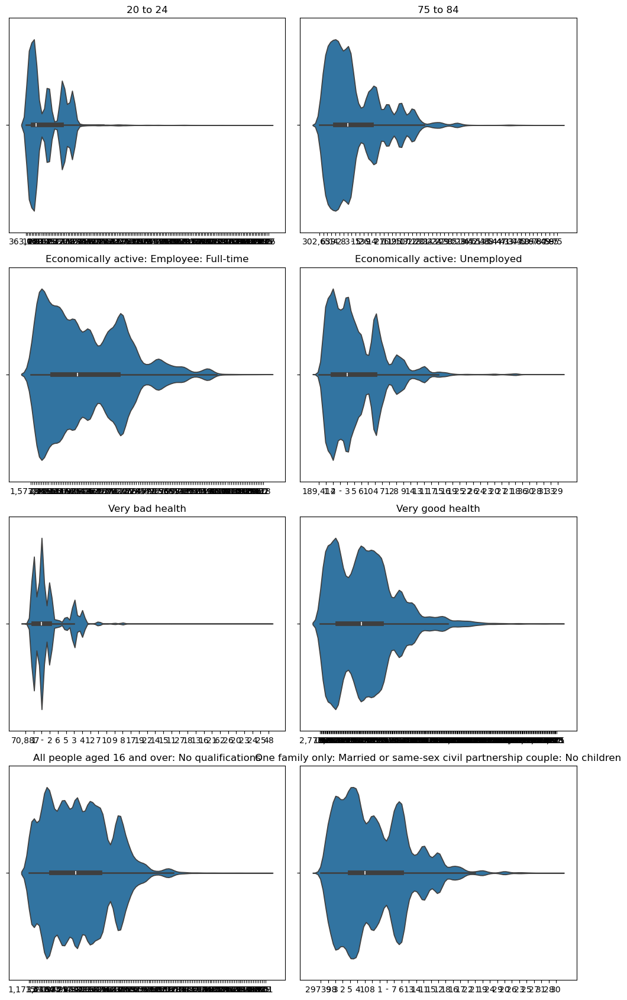

In [83]:
# violin plots

import seaborn as sns
import matplotlib.pyplot as plt

attributes_to_plot = ['20 to 24',
                      '75 to 84',
                      'Economically active: Employee: Full-time',
                      'Economically active: Unemployed',
                      'Very bad health',
                      'Very good health',
                      'All people aged 16 and over: No qualifications',
                      'One family only: Married or same-sex civil partnership couple: No children']

plt.figure(figsize=(10, 17))

for i, attribute in enumerate(attributes_to_plot, 1):
    plt.subplot(4, 2, i)
    sns.violinplot(x=merged_data[attribute])
    plt.title(attribute)
    plt.xlabel('')
    plt.ylabel('')

plt.tight_layout()
plt.show()

screenshots

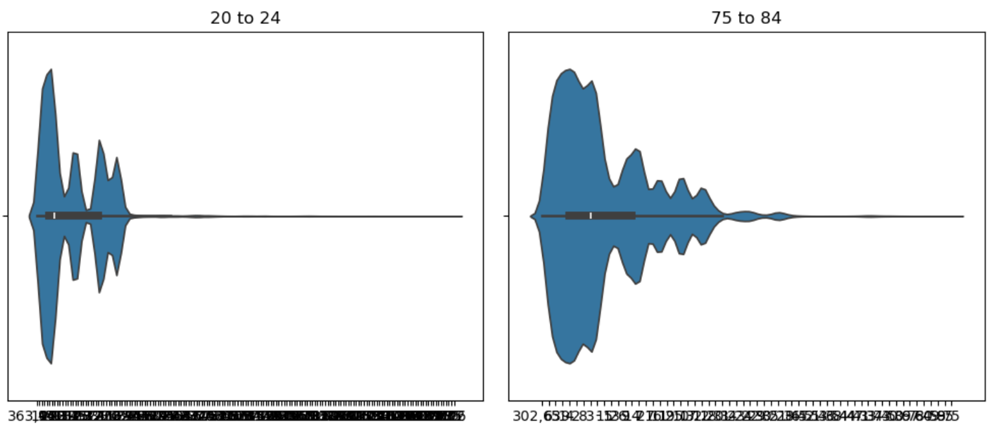
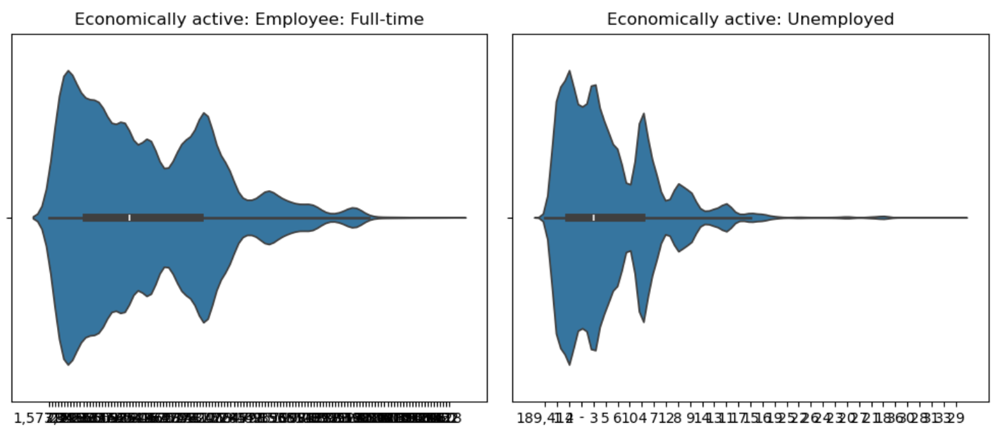
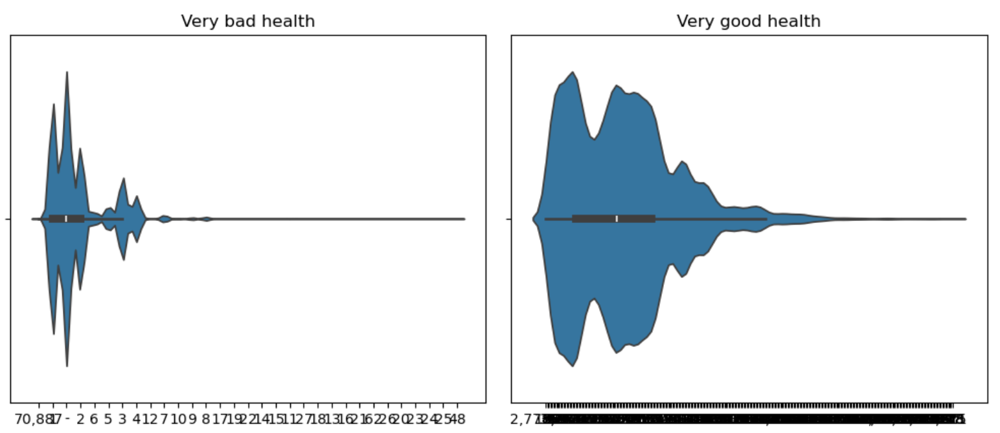
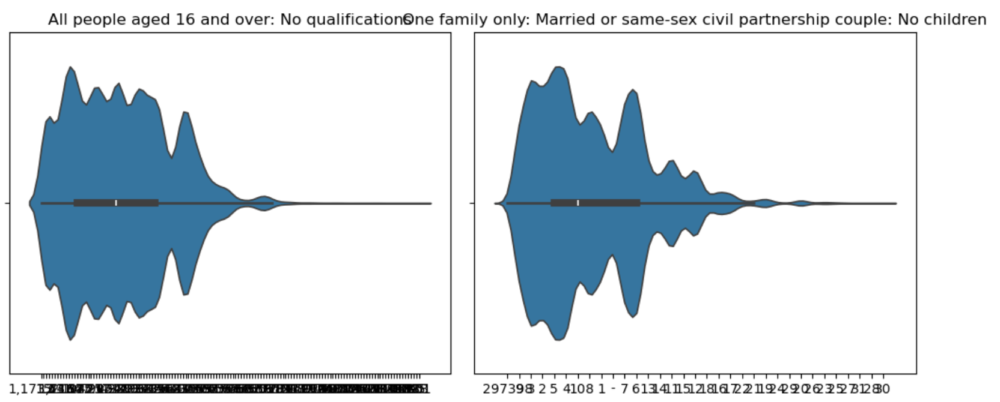

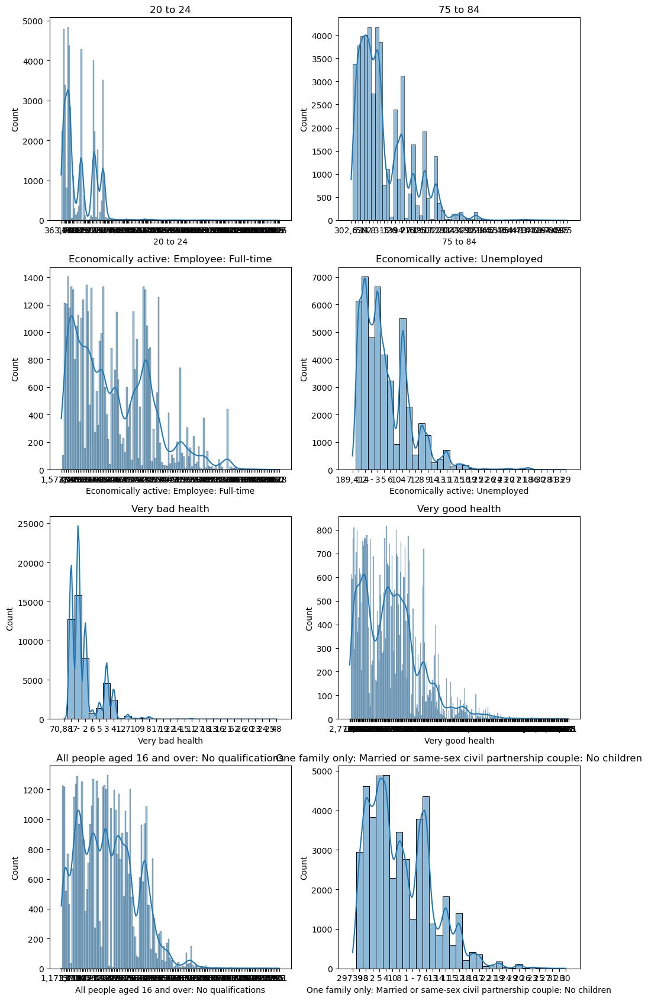

In [84]:
# histograms 

import seaborn as sns
import matplotlib.pyplot as plt

attributes_to_plot = ['20 to 24',
                      '75 to 84',
                      'Economically active: Employee: Full-time',
                      'Economically active: Unemployed',
                      'Very bad health',
                      'Very good health',
                      'All people aged 16 and over: No qualifications',
                      'One family only: Married or same-sex civil partnership couple: No children']

plt.figure(figsize=(10, 17))

for i, attribute in enumerate(attributes_to_plot, 1):
    plt.subplot(4, 2, i)
    sns.histplot(merged_data[attribute].astype(str), kde=True)
    plt.title(attribute)

plt.tight_layout()
plt.show()

screenshots 

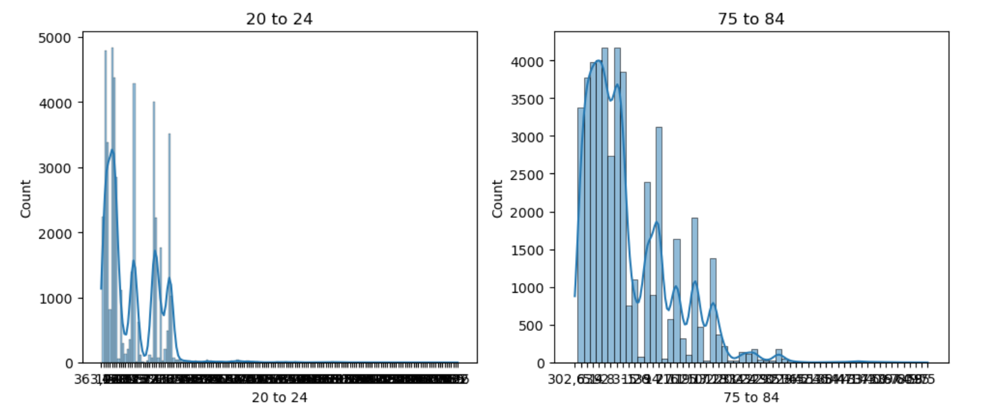
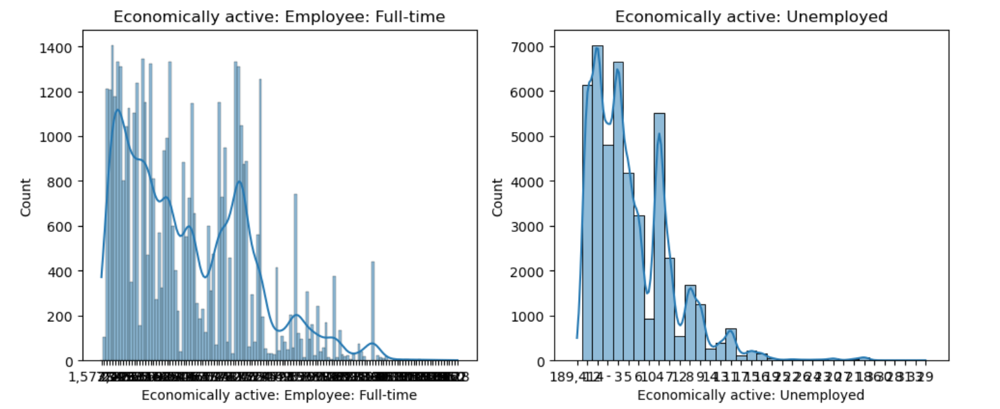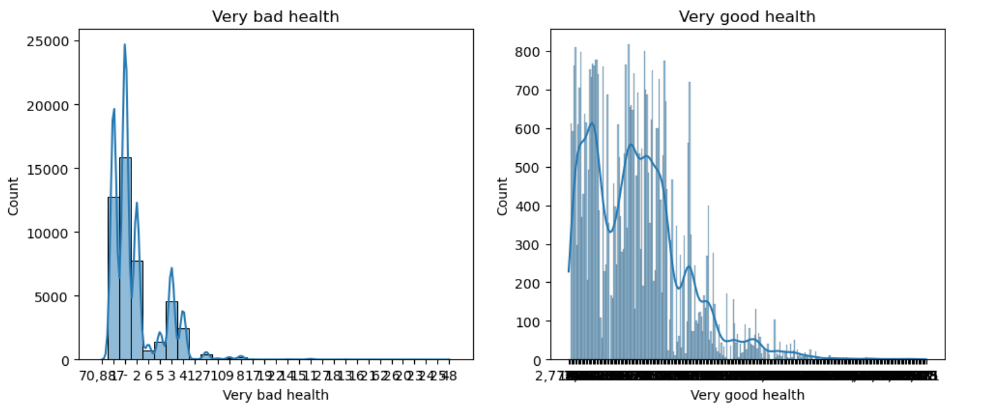
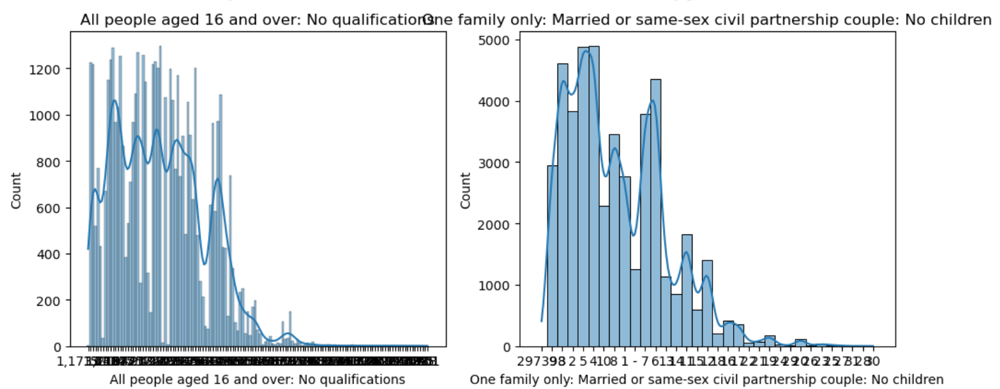



In [89]:
def calculate_percentages(dataframe, total_columns, value_columns):
    result_df = pd.DataFrame()

    for total_col, value_col in zip(total_columns, value_columns):
        percentage_col_name = f"{value_col}_percentage"

        if total_col not in dataframe.columns:
            raise ValueError(f"Total column '{total_col}' not found in the DataFrame.")
        
        # Force values to numeric (handle blanks or missing)
        dataframe[value_col] = pd.to_numeric(dataframe[value_col], errors='coerce')
        dataframe[total_col] = pd.to_numeric(dataframe[total_col], errors='coerce')
        
        result_df[percentage_col_name] = (dataframe[value_col] / dataframe[total_col]) * 100

    return result_df
    
# Totals for percentage calculation
total_cols = [
    'All people',                                 # 20 to 24
    'All people',                                 # 75 to 84
    'All people aged 16 to 74',                   # Full-time employees
    'All people aged 16 to 74',                   # Unemployed
    'All people',                                 # Very bad health
    'All people',                                 # Very good health
    'All people aged 16 and over',                # No qualifications
    'All households'                              # Household type: married, no kids
]

# Matching variables you want to convert to percentages
value_cols = [
    '20 to 24',
    '75 to 84',
    'Economically active: Employee: Full-time',
    'Economically active: Unemployed',
    'Very bad health',
    'Very good health',
    'All people aged 16 and over: No qualifications',
    'One family only: Married or same-sex civil partnership couple: No children'
]

# Run the function
result_dataframe = calculate_percentages(edi_merg, total_cols, value_cols)




In [90]:
result_dataframe.head()

,20 to 24_percentage,75 to 84_percentage,Economically active: Employee: Full-time_percentage,Economically active: Unemployed_percentage,Very bad health_percentage,Very good health_percentage,All people aged 16 and over: No qualifications_percentage,One family only: Married or same-sex civil partnership couple: No children_percentage
0,3.750000,5.000000,52.459016,NaN,NaN,61.250000,14.925373,11.428571
1,2.985075,3.731343,37.755102,2.040816,NaN,45.522388,40.952381,18.000000
2,1.388889,20.833333,38.235294,NaN,1.388889,41.666667,31.343284,6.666667
3,3.846154,2.884615,28.235294,NaN,1.923077,56.730769,4.444444,37.777778
4,NaN,3.448276,62.500000,2.777778,1.149425,72.413793,2.666667,13.043478


In [91]:
result_dataframe.shape

(4322, 8)

In [93]:
concatenated_df = pd.concat([edi_merg, result_dataframe], axis=1, ignore_index=False)
concatenated_df.head()

,OBJECTID,oa_code,HHcount,Popcount,council,sqkm,hect,masterpc,easting,northing,...,All people aged 16 and over: No qualifications_percentage,One family only: Married or same-sex civil partnership couple: No children_percentage,20 to 24_percentage,75 to 84_percentage,Economically active: Employee: Full-time_percentage,Economically active: Unemployed_percentage,Very bad health_percentage,Very good health_percentage,All people aged 16 and over: No qualifications_percentage,One family only: Married or same-sex civil partnership couple: No children_percentage
0,7307,S00104290,35,80,S12000036,0.005849,0.584871,EH6 8AJ,327509,675739,...,14.925373,11.428571,3.750000,5.000000,52.459016,NaN,NaN,61.250000,14.925373,11.428571
1,7308,S00105247,50,134,S12000036,0.015458,1.545845,EH11 3UN,319980,671252,...,40.952381,18.000000,2.985075,3.731343,37.755102,2.040816,NaN,45.522388,40.952381,18.000000
2,7309,S00107429,45,72,S12000036,0.012086,1.208595,EH14 1DD,322954,670960,...,31.343284,6.666667,1.388889,20.833333,38.235294,NaN,1.388889,41.666667,31.343284,6.666667
3,7310,S00105740,45,104,S12000036,0.372084,37.208371,EH14 1DN,322537,669850,...,4.444444,37.777778,3.846154,2.884615,28.235294,NaN,1.923077,56.730769,4.444444,37.777778
4,7311,S00105450,46,87,S12000036,0.021571,2.157070,EH12 6AN,323001,673215,...,2.666667,13.043478,NaN,3.448276,62.500000,2.777778,1.149425,72.413793,2.666667,13.043478


In [94]:
concatenated_df.shape

(4322, 137)

In [95]:
list(concatenated_df.columns)

['OBJECTID',
 'oa_code',
 'HHcount',
 'Popcount',
 'council',
 'sqkm',
 'hect',
 'masterpc',
 'easting',
 'northing',
 'SHAPE_1_Le',
 'SHAPE_1_Ar',
 'DataZone',
 'geometry',
 'All people aged 16 and over',
 'All people aged 16 and over: No qualifications',
 'All people aged 16 and over: Level 1',
 'All people aged 16 and over: Level 2',
 'All people aged 16 and over: Level 3',
 'All people aged 16 and over: Level 4 and above',
 'All people',
 '0 to 4',
 '5 to 7',
 '8 to 9',
 '10 to 14',
 '15',
 '16 to 17',
 '18 to 19',
 '20 to 24',
 '25 to 29',
 '30 to 44',
 '45 to 59',
 '60 to 64',
 '65 to 74',
 '75 to 84',
 '85 to 89',
 '90 and over',
 'Mean age',
 'Median age',
 'Church of Scotland',
 'Roman Catholic',
 'Other Christian',
 'Buddhist',
 'Hindu',
 'Jewish',
 'Muslim',
 'Sikh',
 'Other religion',
 'No religion',
 'Religion not stated',
 'Single (never married or never registered a same-sex civil partnership)',
 'Married',
 'In a registered same-sex civil partnership',
 'Separated (but 

In [98]:
keep_cols= ['oa_code',
    'Popcount',
    'HHcount',
    'DataZone',
    'geometry',
    '20 to 24',
    '75 to 84',
    'Economically active: Employee: Full-time',
    'Economically active: Unemployed',
    'Very bad health',
    'Very good health',
    'All people aged 16 and over: No qualifications',
    'One family only: Married or same-sex civil partnership couple: No children'
]

edi_census_data = concatenated_df[keep_cols]

In [99]:
edi_census_data.head()

,oa_code,Popcount,HHcount,DataZone,geometry,20 to 24,75 to 84,Economically active: Employee: Full-time,Economically active: Unemployed,Very bad health,Very good health,All people aged 16 and over: No qualifications,One family only: Married or same-sex civil partnership couple: No children
0,S00104290,80,35,S01008792,"POLYGON ((327555.000 675752.000, 327536.846 67...",3.0,4.0,32.0,NaN,NaN,49.0,10.0,4.0
1,S00105247,134,50,S01008468,"POLYGON ((319915.000 671377.000, 319937.954 67...",4.0,5.0,37.0,2.0,NaN,61.0,43.0,9.0
2,S00107429,72,45,S01008509,"POLYGON ((323024.000 671021.000, 323009.001 67...",1.0,15.0,13.0,NaN,1.0,30.0,21.0,3.0
3,S00105740,104,45,S01008511,"POLYGON ((322653.000 670327.000, 322674.000 67...",4.0,3.0,24.0,NaN,2.0,59.0,4.0,17.0
4,S00105450,87,46,S01008873,"POLYGON ((323089.000 673352.000, 323112.000 67...",NaN,3.0,45.0,2.0,1.0,63.0,2.0,6.0


In [100]:
# standarisation

numeric_columns = edi_census_data.select_dtypes(include='float64')
z_score_df = (numeric_columns - numeric_columns.mean()) / numeric_columns.std(ddof=0)
z_score_df.head()

,20 to 24,75 to 84,Economically active: Employee: Full-time,Economically active: Unemployed,Very bad health,Very good health,All people aged 16 and over: No qualifications,One family only: Married or same-sex civil partnership couple: No children
0,-0.453793,-0.441868,-0.178754,NaN,NaN,-0.499060,-0.468839,-0.497067
1,-0.399120,-0.263595,0.169581,-0.626438,NaN,-0.070777,1.996119,0.942970
2,-0.563140,1.519135,-1.502428,NaN,-0.623238,-1.177173,0.352813,-0.785075
3,-0.399120,-0.620141,-0.736090,NaN,-0.027389,-0.142158,-0.917013,3.247029
4,NaN,-0.620141,0.726918,-0.626438,-0.623238,0.000603,-1.066405,0.078948


In [101]:
corr = z_score_df.corr()
corr.style.background_gradient(cmap='coolwarm')

,20 to 24,75 to 84,Economically active: Employee: Full-time,Economically active: Unemployed,Very bad health,Very good health,All people aged 16 and over: No qualifications,One family only: Married or same-sex civil partnership couple: No children
20 to 24,1.000000,-0.153459,0.092157,0.035895,0.006457,0.463880,-0.101966,-0.117382
75 to 84,-0.153459,1.000000,-0.188289,-0.164580,0.268185,-0.027673,0.400787,0.162453
Economically active: Employee: Full-time,0.092157,-0.188289,1.000000,-0.046533,-0.171951,0.532086,-0.168116,0.379324
Economically active: Unemployed,0.035895,-0.164580,-0.046533,1.000000,0.162955,-0.023824,0.353823,-0.194124
Very bad health,0.006457,0.268185,-0.171951,0.162955,1.000000,-0.108812,0.561804,-0.122864
Very good health,0.463880,-0.027673,0.532086,-0.023824,-0.108812,1.000000,-0.120400,0.401874
All people aged 16 and over: No qualifications,-0.101966,0.400787,-0.168116,0.353823,0.561804,-0.120400,1.000000,-0.066835
One family only: Married or same-sex civil partnership couple: No children,-0.117382,0.162453,0.379324,-0.194124,-0.122864,0.401874,-0.066835,1.000000


screenshot

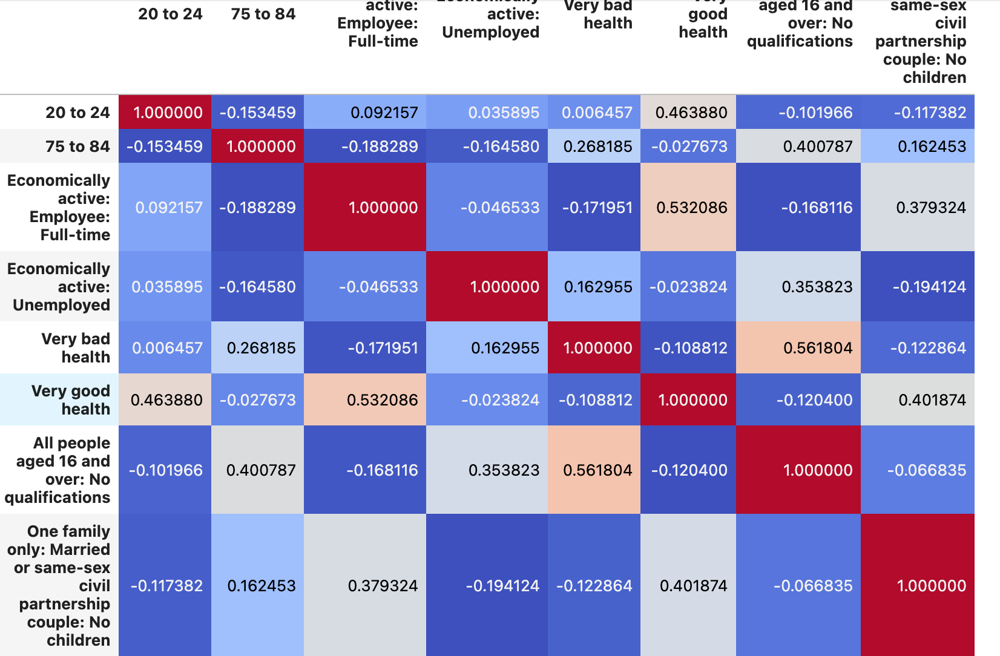

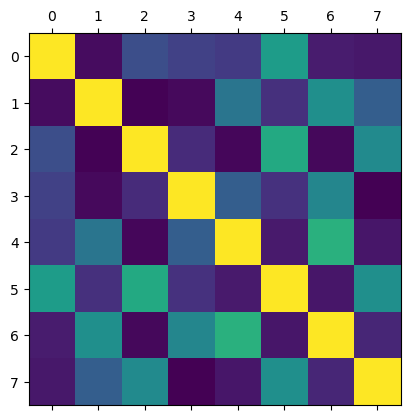

In [102]:
import matplotlib.pyplot as plt

plt.matshow(z_score_df.corr())
plt.show()

screenshot

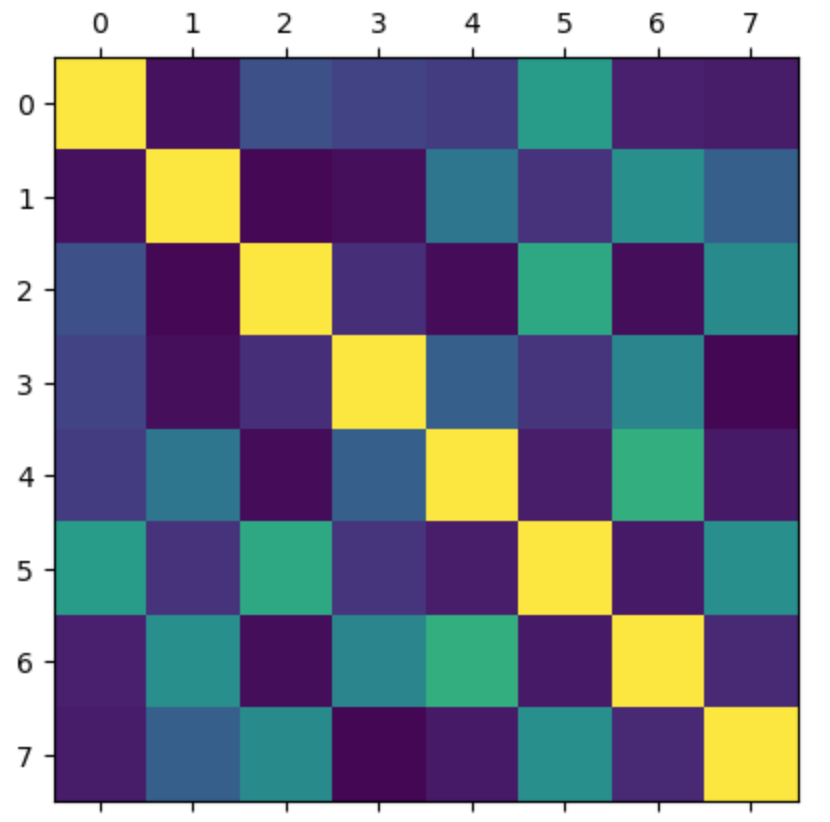

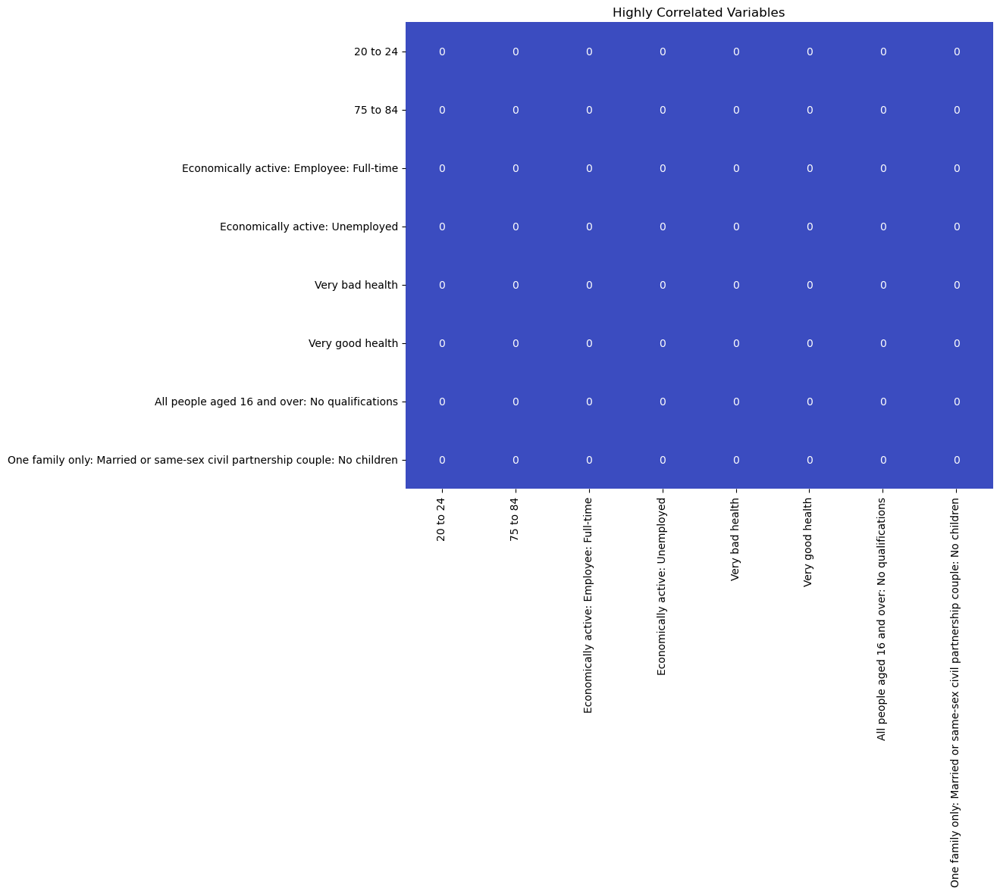

In [103]:
threshold = 0.7 
highly_correlated = (corr.abs() > threshold) & (corr.abs() < 1.0)

plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated, cmap='coolwarm', cbar=False, annot=True)

plt.title('Highly Correlated Variables')
plt.show()

# there are no highly correlated varaiables so therefore no data needs to be removed

screenshot

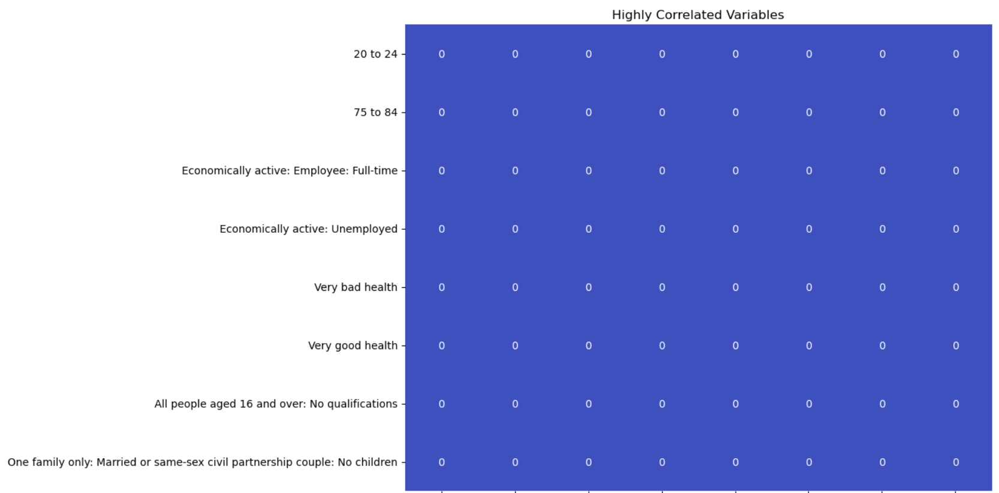

In [108]:
# removing nan values 

z_score_df.isna().sum()

20 to 24                                                                        90
75 to 84                                                                       536
Economically active: Employee: Full-time                                         8
Economically active: Unemployed                                                551
Very bad health                                                               2016
Very good health                                                                 2
All people aged 16 and over: No qualifications                                  64
One family only: Married or same-sex civil partnership couple: No children     134
dtype: int64

I have quite a few missing nan values so I think its best to impute the missing values then recalculate the z scores to avoid skewing the data too much. To do this i will use the median for this as there are so many missing values and this will help avoid skewd data.  

In [110]:
numeric_columns = edi_census_data.select_dtypes(include='float64')
numeric_columns.fillna(z_score_df.median(), inplace=True)

In [111]:
numeric_columns

,20 to 24,75 to 84,Economically active: Employee: Full-time,Economically active: Unemployed,Very bad health,Very good health,All people aged 16 and over: No qualifications,One family only: Married or same-sex civil partnership couple: No children
0,3.0000,4.000000,32.0,-0.287757,-0.623238,49.0,10.0,4.0
1,4.0000,5.000000,37.0,2.000000,-0.623238,61.0,43.0,9.0
2,1.0000,15.000000,13.0,-0.287757,1.000000,30.0,21.0,3.0
3,4.0000,3.000000,24.0,-0.287757,2.000000,59.0,4.0,17.0
4,-0.2351,3.000000,45.0,2.000000,1.000000,63.0,2.0,6.0
...,...,...,...,...,...,...,...,...
4317,4.0000,3.000000,19.0,1.000000,-0.623238,22.0,10.0,3.0
4318,10.0000,-0.263595,24.0,3.000000,2.000000,43.0,6.0,4.0
4319,13.0000,6.000000,26.0,-0.287757,-0.623238,46.0,5.0,6.0
4320,45.0000,1.000000,14.0,2.000000,-0.623238,53.0,11.0,2.0


In [112]:
z_score_df = (numeric_columns - numeric_columns.mean()) / numeric_columns.std(ddof=0)
z_score_df.head()

,20 to 24,75 to 84,Economically active: Employee: Full-time,Economically active: Unemployed,Very bad health,Very good health,All people aged 16 and over: No qualifications,One family only: Married or same-sex civil partnership couple: No children
0,-0.443488,-0.288101,-0.173509,-1.170557,-0.786842,-0.497548,-0.448905,-0.431978
1,-0.388464,-0.112693,0.173281,-0.428729,-0.786842,-0.069669,2.006971,0.968843
2,-0.553537,1.641391,-1.491312,-1.170557,0.109994,-1.175024,0.369720,-0.712143
3,-0.388464,-0.463510,-0.728374,-1.170557,0.662493,-0.140982,-0.895428,3.210157
4,-0.621497,-0.463510,0.728145,-0.428729,0.109994,0.001644,-1.044269,0.128350


In [113]:
corr = z_score_df.corr()
corr.style.background_gradient(cmap='coolwarm')

,20 to 24,75 to 84,Economically active: Employee: Full-time,Economically active: Unemployed,Very bad health,Very good health,All people aged 16 and over: No qualifications,One family only: Married or same-sex civil partnership couple: No children
20 to 24,1.000000,-0.179853,0.103341,0.058900,-0.036888,0.347338,-0.110113,-0.124953
75 to 84,-0.179853,1.000000,-0.204621,-0.188435,0.259703,-0.011804,0.434214,0.192088
Economically active: Employee: Full-time,0.103341,-0.204621,1.000000,0.016983,-0.175082,0.534473,-0.173020,0.405492
Economically active: Unemployed,0.058900,-0.188435,0.016983,1.000000,0.227392,-0.000138,0.356613,-0.194979
Very bad health,-0.036888,0.259703,-0.175082,0.227392,1.000000,-0.139589,0.587532,-0.116426
Very good health,0.347338,-0.011804,0.534473,-0.000138,-0.139589,1.000000,-0.119921,0.401998
All people aged 16 and over: No qualifications,-0.110113,0.434214,-0.173020,0.356613,0.587532,-0.119921,1.000000,-0.062149
One family only: Married or same-sex civil partnership couple: No children,-0.124953,0.192088,0.405492,-0.194979,-0.116426,0.401998,-0.062149,1.000000


screenshot
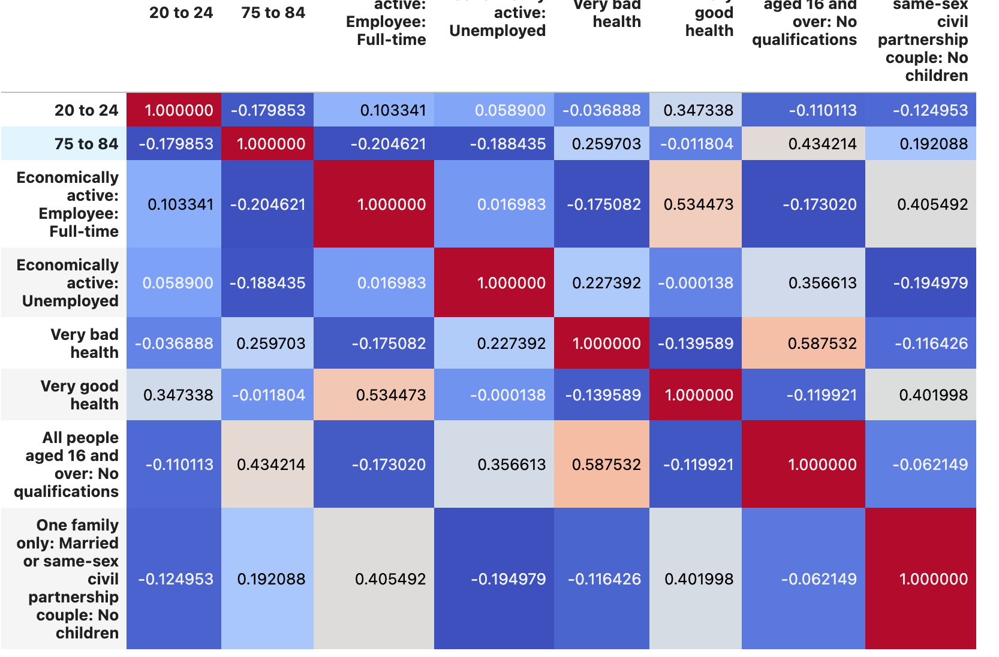

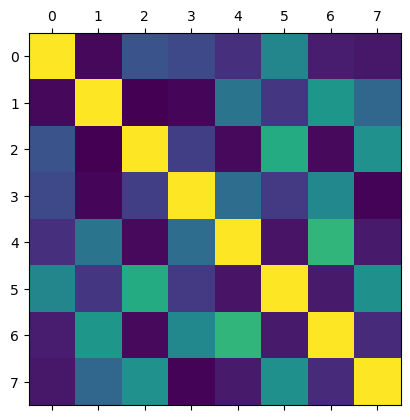

In [114]:
import matplotlib.pyplot as plt

plt.matshow(z_score_df.corr())
plt.show()

screenshot
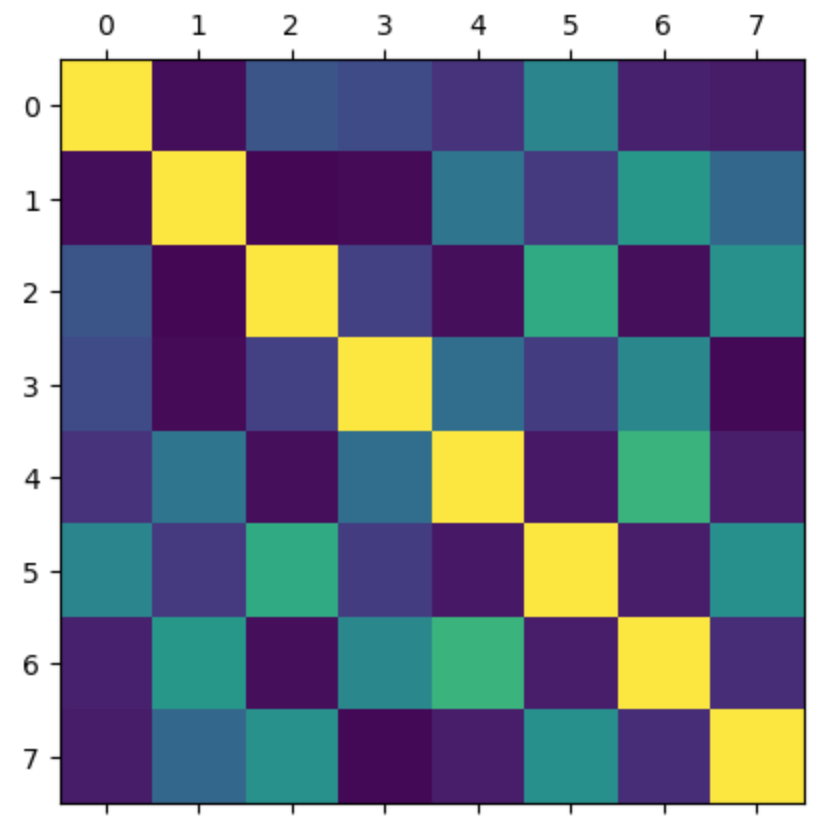

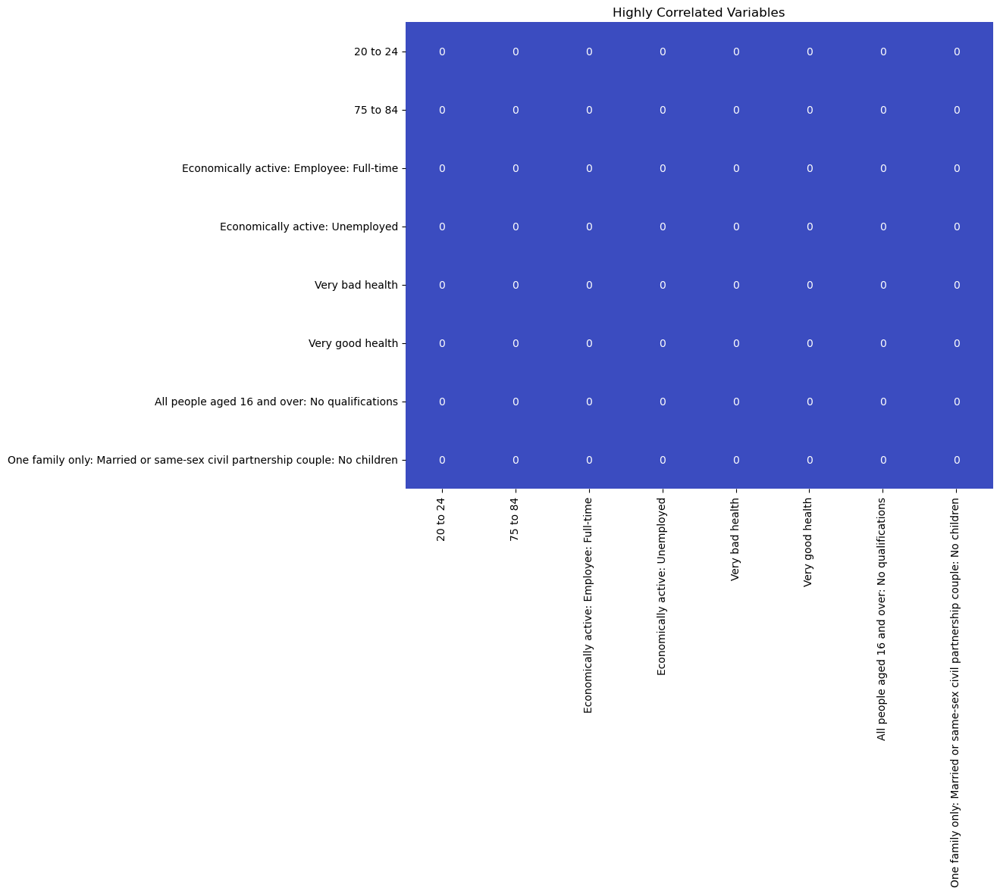

In [115]:
threshold = 0.7 
highly_correlated = (corr.abs() > threshold) & (corr.abs() < 1.0)

plt.figure(figsize=(10, 8))
sns.heatmap(highly_correlated, cmap='coolwarm', cbar=False, annot=True)

plt.title('Highly Correlated Variables')
plt.show()

# once again there are no highly correlated variables so nothing needs to be removed so can move on

screenshot
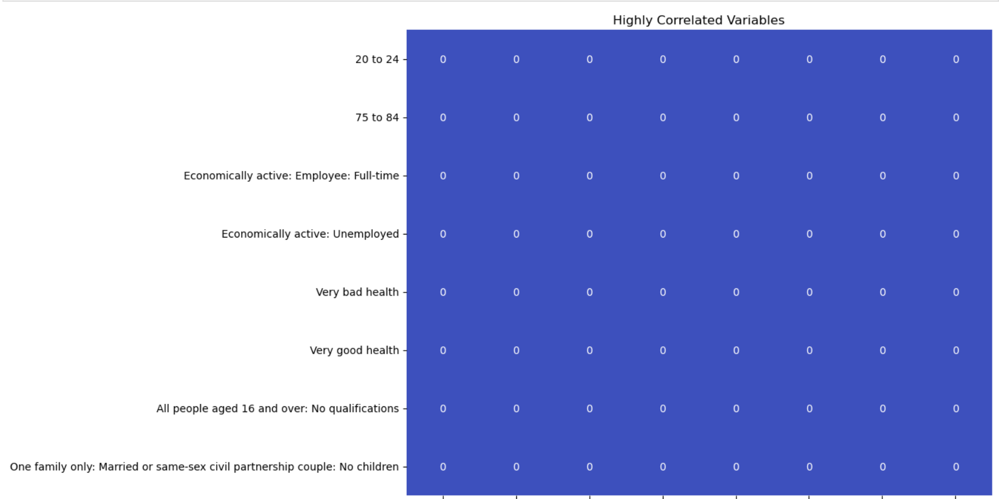

In [117]:
# double checking there are no nan values 

contains_nan = z_score_df.isna().any().any()

if contains_nan:
    print("NaN values.")
else:
    print("no NaN values")

no NaN values


In [119]:
# k clustering 
?KMeans

Object `KMeans` not found.


In [120]:
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist, pdist

# KMeans with 10 clusters
kmeans = KMeans(n_clusters=10)
kmeans.fit(z_score_df)
labels = kmeans.predict(z_score_df)
cluster_centres = kmeans.cluster_centers_
z_score_df['Cluster'] = kmeans.labels_

In [121]:
z_score_df.head()

,20 to 24,75 to 84,Economically active: Employee: Full-time,Economically active: Unemployed,Very bad health,Very good health,All people aged 16 and over: No qualifications,One family only: Married or same-sex civil partnership couple: No children,Cluster
0,-0.443488,-0.288101,-0.173509,-1.170557,-0.786842,-0.497548,-0.448905,-0.431978,9
1,-0.388464,-0.112693,0.173281,-0.428729,-0.786842,-0.069669,2.006971,0.968843,1
2,-0.553537,1.641391,-1.491312,-1.170557,0.109994,-1.175024,0.369720,-0.712143,4
3,-0.388464,-0.463510,-0.728374,-1.170557,0.662493,-0.140982,-0.895428,3.210157,3
4,-0.621497,-0.463510,0.728145,-0.428729,0.109994,0.001644,-1.044269,0.128350,2


(array([ 96., 408., 738., 709., 354.,  87., 471., 225., 392., 842.]),
 array([0. , 0.9, 1.8, 2.7, 3.6, 4.5, 5.4, 6.3, 7.2, 8.1, 9. ]),
 <BarContainer object of 10 artists>)

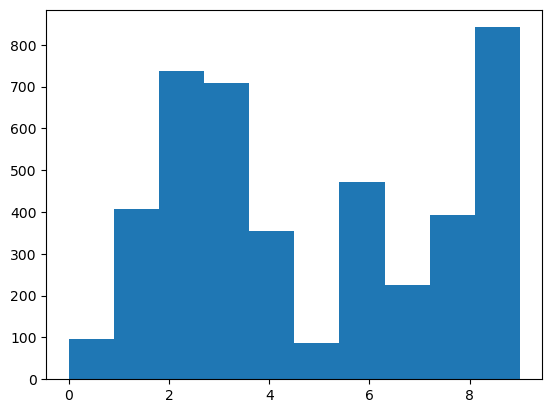

In [122]:
plt.hist(labels)

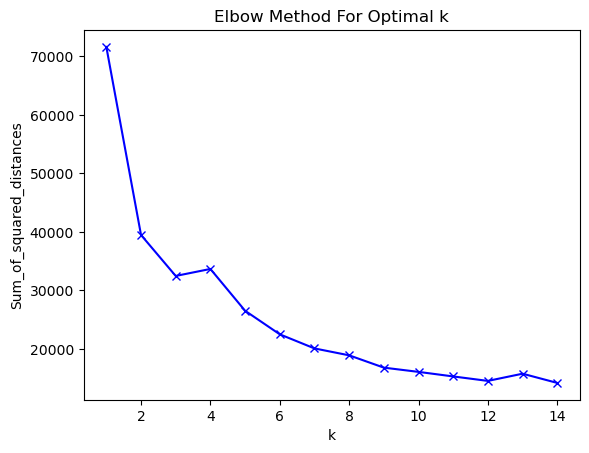

In [123]:
Sum_of_squared_distances = []

K_range = range(1,15)

for k in K_range:
 km = KMeans(n_clusters=k)
 km = km.fit(z_score_df)
 Sum_of_squared_distances.append(km.inertia_)
    
plt.plot(K_range, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

screenshot

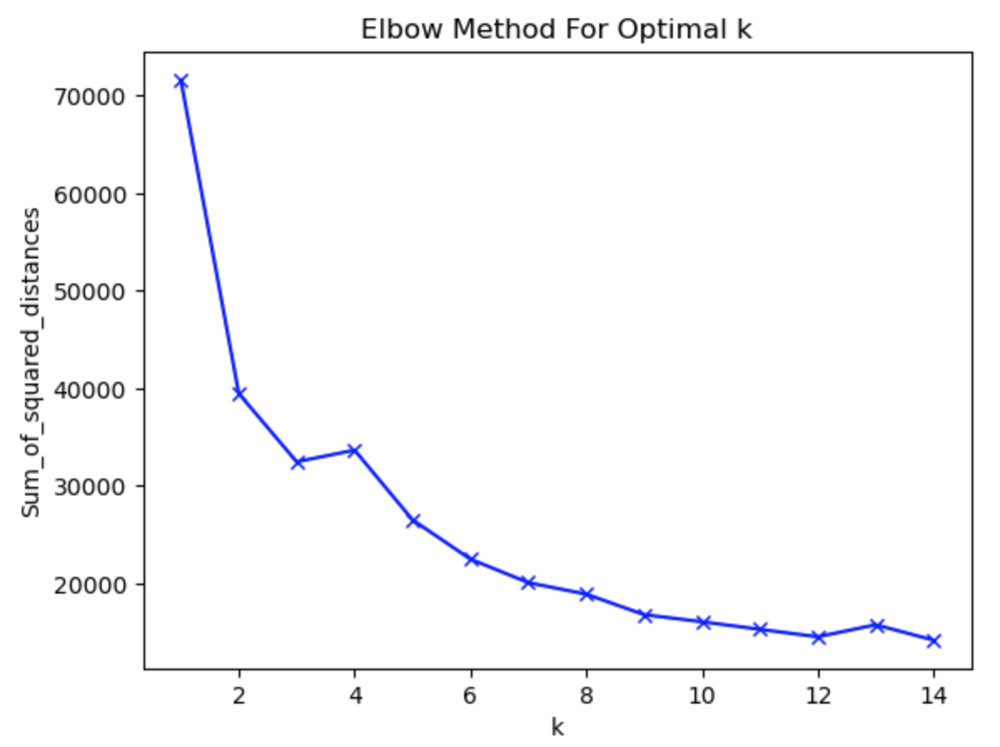

From using the elbow method i will experiment with cluster groups of three or four. 

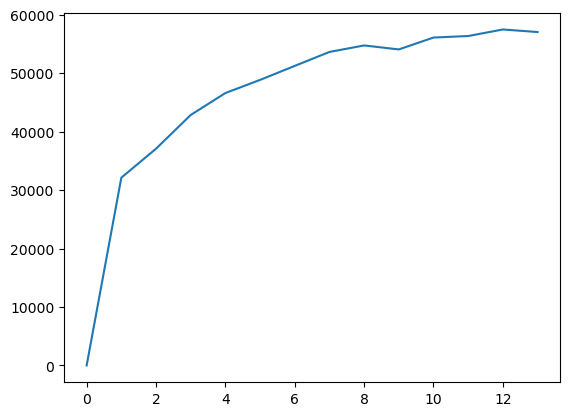

In [124]:
import numpy as np
def elbow(dataframe, n):
    kMeansVar = [KMeans(n_clusters=k).fit(dataframe.values) for k in range(1, n)] #making use of list comprehensions.
    centroids = [X.cluster_centers_ for X in kMeansVar]
    k_euclid = [cdist(dataframe.values, cent) for cent in centroids]
    dist = [np.min(ke, axis=1) for ke in k_euclid]
    wcss = [sum(d**2) for d in dist]
    tss = sum(pdist(dataframe.values)**2)/dataframe.values.shape[0]
    bss = tss - wcss
    plt.plot(bss)
    plt.show()
 
elbow(z_score_df,15)

screenshot
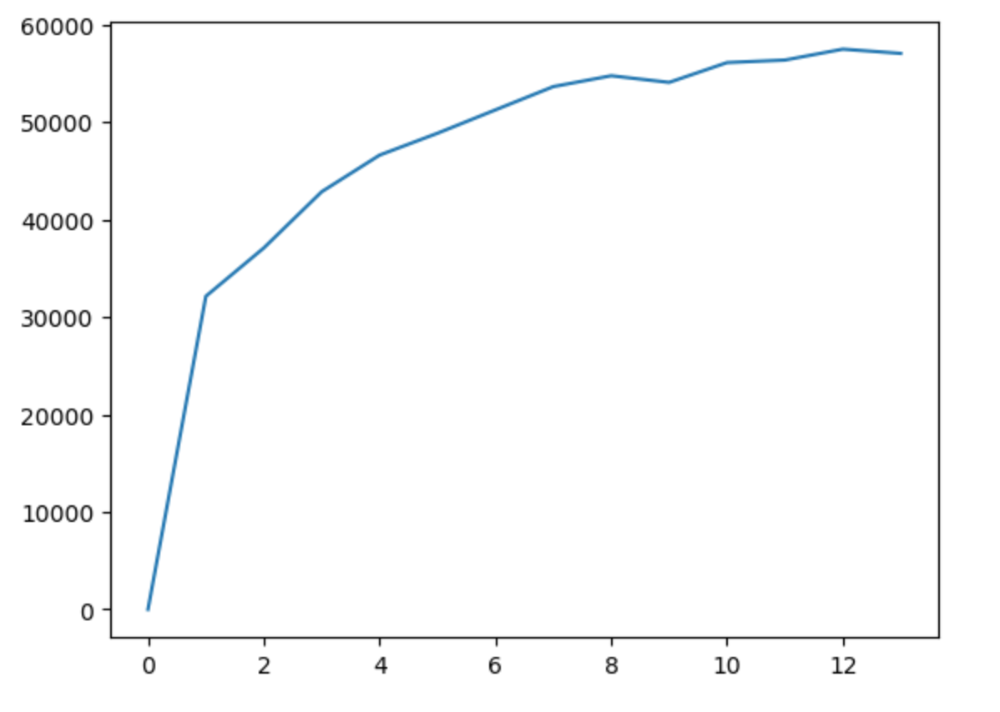

This plot shows an optium cluster group of four or five. 

In [132]:
### experimenting with three cluster groups

import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

plt.figure(figsize=(12, 8))

kmeans = KMeans(n_clusters=3)
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df)

# PCA analysys.
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

# Create a scatter plot
fig = px.scatter(x=pca_result[:, 0], y=pca_result[:, 1], color=clusters,
                 labels={'color': 'Cluster'},
                 #title='Cluster Plot against 1st 2 Principal Components',
                 opacity=0.7,
                 width=800, 
                 height=800)

plt.tight_layout()
fig.show()

print(f"These two components explain {(variance_ratio.sum()*100):.2f}% of the point variability.")


These two components explain 47.22% of the point variability.


<Figure size 1200x800 with 0 Axes>

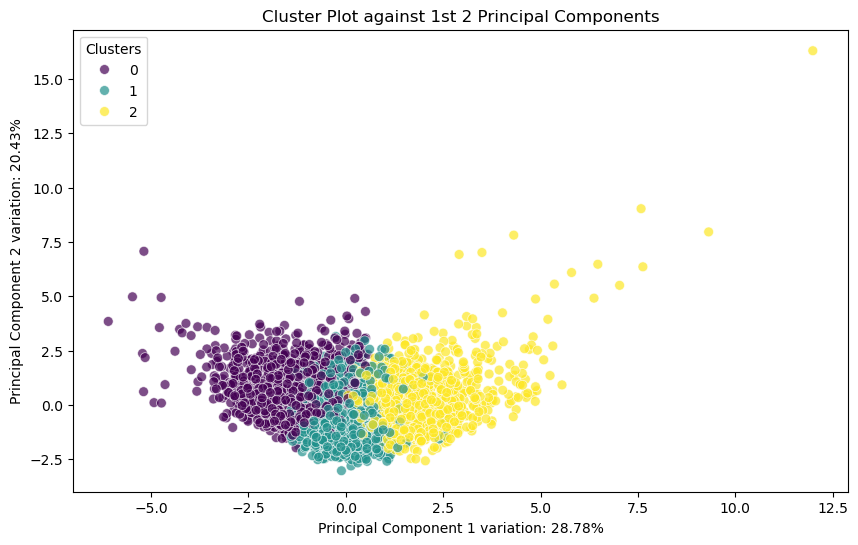

In [128]:
kmeans = KMeans(n_clusters=3)
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

# Standardize the data for PCA
scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df.drop(columns='Cluster')) 

# PCA
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=clusters, palette='viridis', s=50, alpha=0.7)
plt.title('Cluster Plot against 1st 2 Principal Components')
plt.xlabel(f'Principal Component 1 variation: {variance_ratio[0]*100:.2f}%')
plt.ylabel(f'Principal Component 2 variation: {variance_ratio[1]*100:.2f}%')
plt.legend(title='Clusters')
plt.show()


screenshots for 3 cluster groups

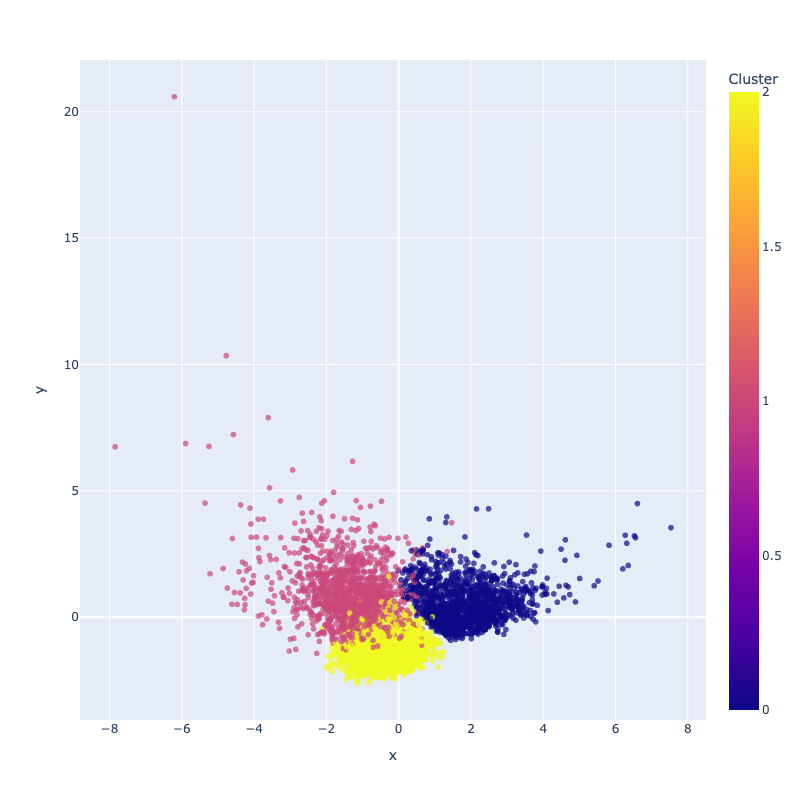
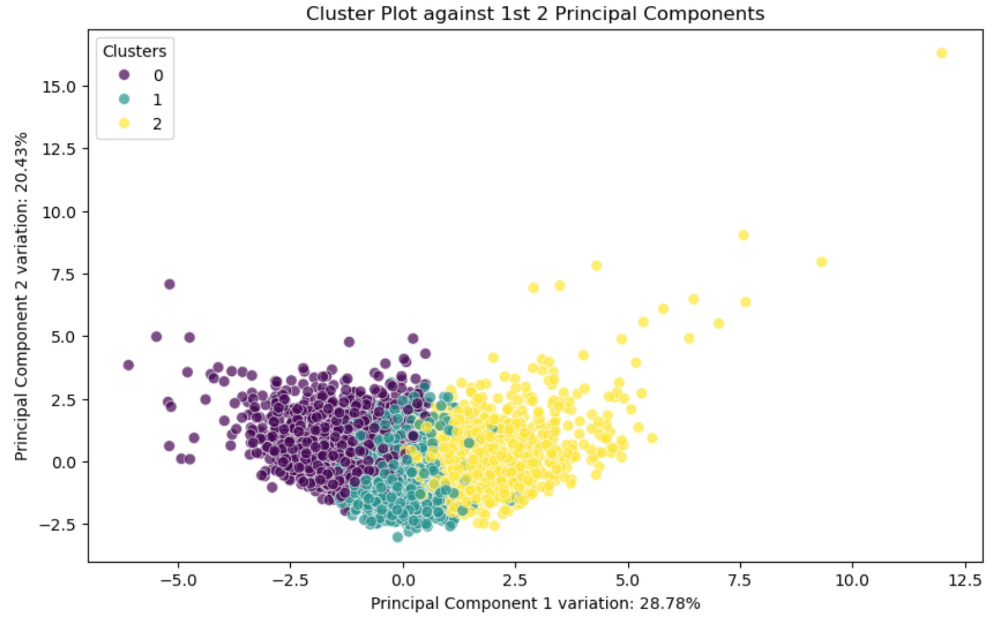

In [143]:
### experimenting with 4 cluster groups 

plt.figure(figsize=(12, 8))

kmeans = KMeans(n_clusters=4)
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df)

# PCA analysys.
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

# Create a scatter plot
fig = px.scatter(x=pca_result[:, 0], y=pca_result[:, 1], color=clusters,
                 labels={'color': 'Cluster'},
                 #title='Cluster Plot against 1st 2 Principal Components',
                 opacity=0.7,
                 width=800, 
                 height=800)

plt.tight_layout()
fig.show()

print(f"These two components explain {(variance_ratio.sum()*100):.2f}% of the point variability.")



ValueError: n_components=2 must be between 0 and min(n_samples, n_features)=1 with svd_solver='covariance_eigh'

<Figure size 1200x800 with 0 Axes>

In [144]:
kmeans = KMeans(n_clusters=4)
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

# Standardize the data for PCA
scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df.drop(columns='Cluster')) 

# PCA
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=clusters, palette='viridis', s=50, alpha=0.7)
plt.title('Cluster Plot against 1st 2 Principal Components')
plt.xlabel(f'Principal Component 1 variation: {variance_ratio[0]*100:.2f}%')
plt.ylabel(f'Principal Component 2 variation: {variance_ratio[1]*100:.2f}%')
plt.legend(title='Clusters')
plt.show()

ValueError: at least one array or dtype is required

screenshot for 4 cluster groups

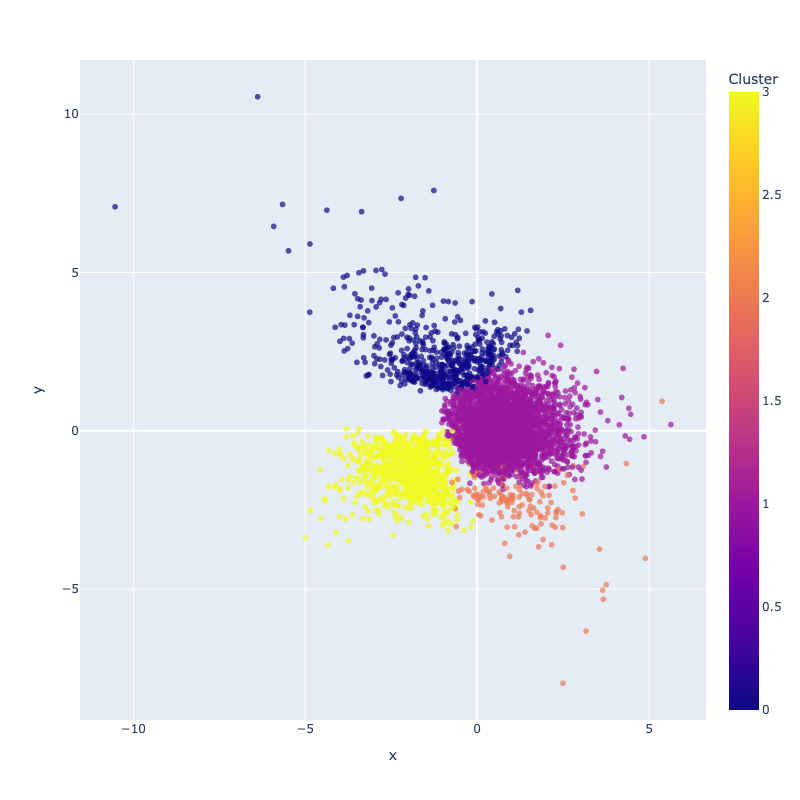
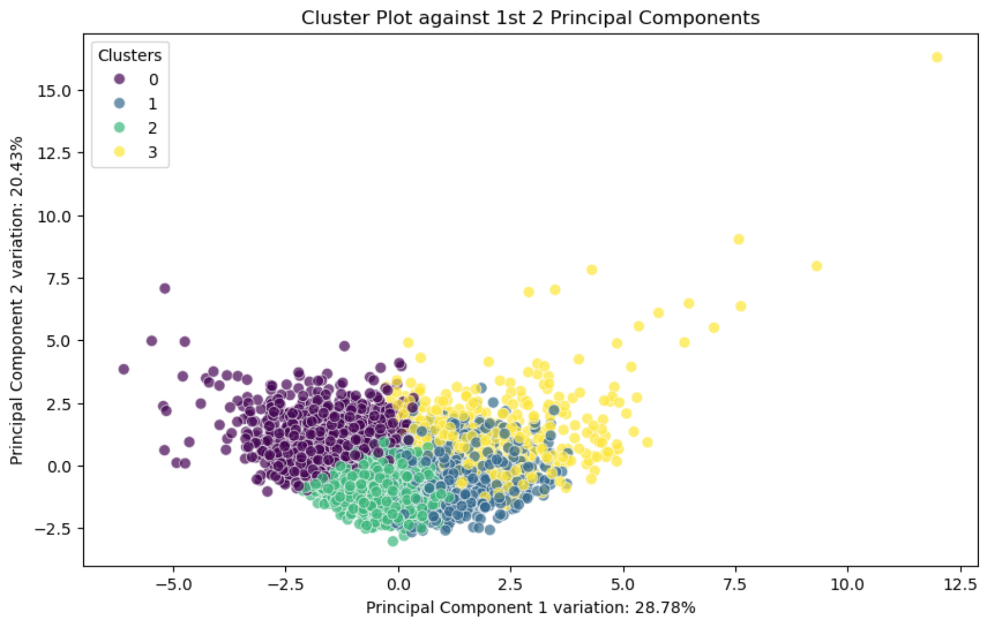

In [136]:
### five cluster groups

plt.figure(figsize=(12, 8))

kmeans = KMeans(n_clusters=5)
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df)

# PCA analysys.
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

# Create a scatter plot
fig = px.scatter(x=pca_result[:, 0], y=pca_result[:, 1], color=clusters,
                 labels={'color': 'Cluster'},
                 #title='Cluster Plot against 1st 2 Principal Components',
                 opacity=0.7,
                 width=800, 
                 height=800)

plt.tight_layout()
fig.show()

print(f"These two components explain {(variance_ratio.sum()*100):.2f}% of the point variability.")



These two components explain 49.67% of the point variability.


<Figure size 1200x800 with 0 Axes>

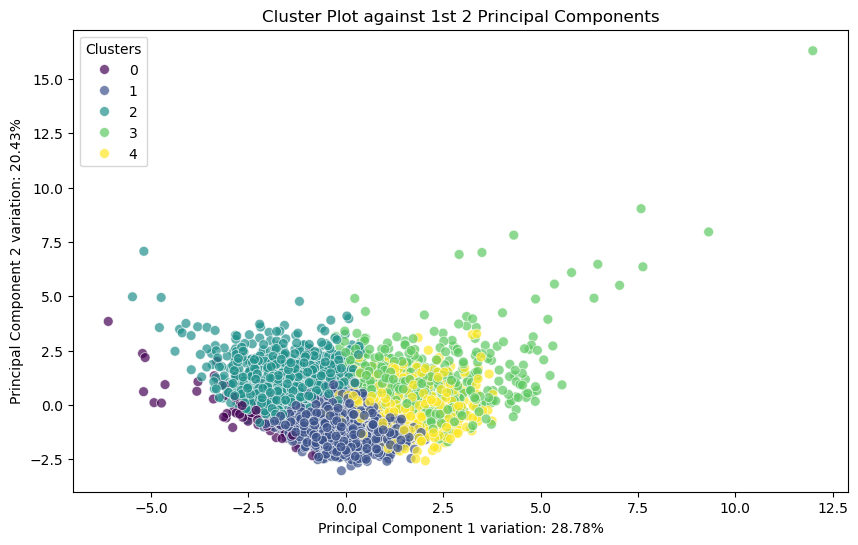

In [137]:
kmeans = KMeans(n_clusters=5)
clusters = kmeans.fit_predict(z_score_df)

z_score_df['Cluster'] = clusters

# Standardize the data for PCA
scaler = StandardScaler()
stand_data_scaled = scaler.fit_transform(z_score_df.drop(columns='Cluster')) 

# PCA
pca = PCA(n_components=2).fit(stand_data_scaled)
pca_result = pca.transform(stand_data_scaled)

#Percentage of variance explained by each of the selected components.
variance_ratio = pca.explained_variance_ratio_

plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=clusters, palette='viridis', s=50, alpha=0.7)
plt.title('Cluster Plot against 1st 2 Principal Components')
plt.xlabel(f'Principal Component 1 variation: {variance_ratio[0]*100:.2f}%')
plt.ylabel(f'Principal Component 2 variation: {variance_ratio[1]*100:.2f}%')
plt.legend(title='Clusters')
plt.show()

screenshots for 5 cluster groups
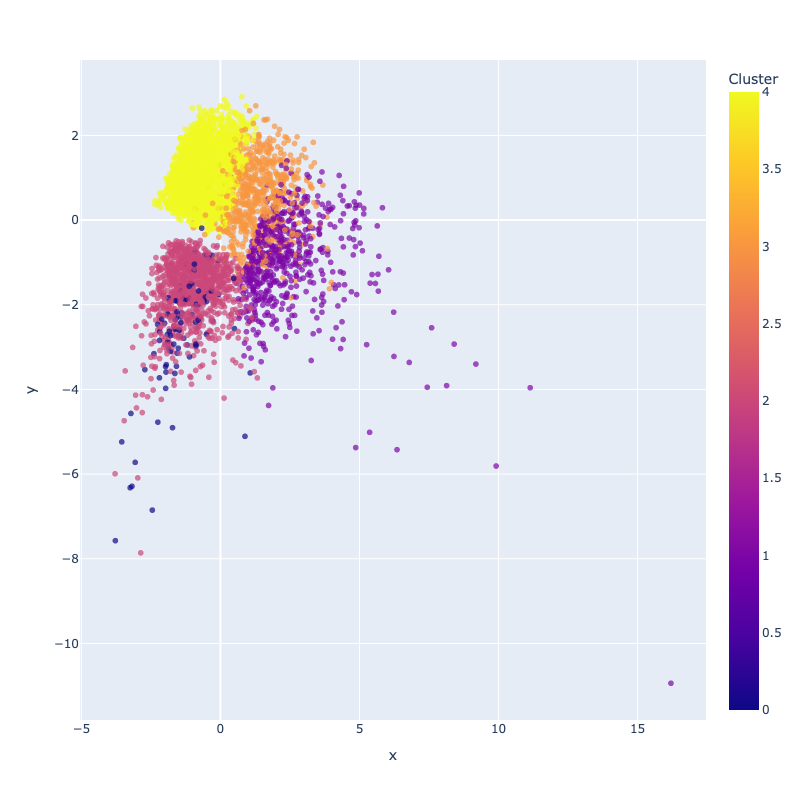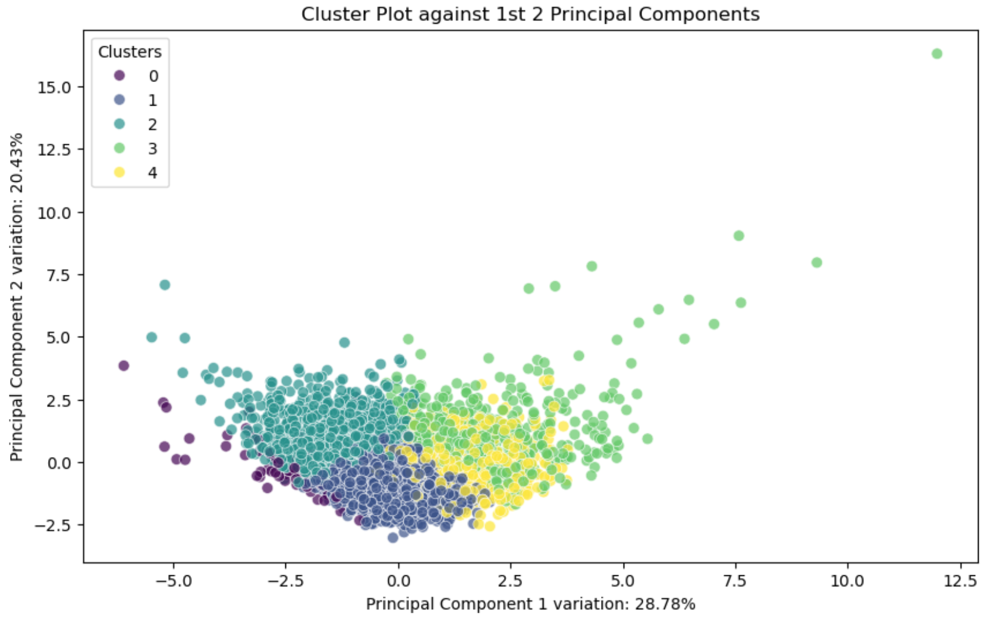


In [138]:
# creating final map

list(z_score_df.columns)

['20 to 24',
 '75 to 84',
 'Economically active: Employee: Full-time',
 'Economically active: Unemployed',
 'Very bad health',
 'Very good health',
 'All people aged 16 and over: No qualifications',
 'One family only: Married or same-sex civil partnership couple: No children',
 'Cluster']

In [139]:
z_score_df.drop(['20 to 24',
 '75 to 84',
 'Economically active: Employee: Full-time',
 'Economically active: Unemployed',
 'Very bad health',
 'Very good health',
 'All people aged 16 and over: No qualifications',
 'One family only: Married or same-sex civil partnership couple: No children'], axis=1, inplace=True)
z_score_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4322 entries, 0 to 4321
Data columns (total 1 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   Cluster  4322 non-null   int32
dtypes: int32(1)
memory usage: 17.0 KB


In [140]:
final_df = pd.concat([edi_census_data, z_score_df], axis=1, ignore_index=False)
final_df.head()

,oa_code,Popcount,HHcount,DataZone,geometry,20 to 24,75 to 84,Economically active: Employee: Full-time,Economically active: Unemployed,Very bad health,Very good health,All people aged 16 and over: No qualifications,One family only: Married or same-sex civil partnership couple: No children,Cluster
0,S00104290,80,35,S01008792,"POLYGON ((327555.000 675752.000, 327536.846 67...",3.0,4.0,32.0,NaN,NaN,49.0,10.0,4.0,1
1,S00105247,134,50,S01008468,"POLYGON ((319915.000 671377.000, 319937.954 67...",4.0,5.0,37.0,2.0,NaN,61.0,43.0,9.0,3
2,S00107429,72,45,S01008509,"POLYGON ((323024.000 671021.000, 323009.001 67...",1.0,15.0,13.0,NaN,1.0,30.0,21.0,3.0,3
3,S00105740,104,45,S01008511,"POLYGON ((322653.000 670327.000, 322674.000 67...",4.0,3.0,24.0,NaN,2.0,59.0,4.0,17.0,2
4,S00105450,87,46,S01008873,"POLYGON ((323089.000 673352.000, 323112.000 67...",NaN,3.0,45.0,2.0,1.0,63.0,2.0,6.0,1


In [142]:
final_df.explore(column='Cluster', cmap='Set1', tiles='CartoDB positron')

screenshot of final map

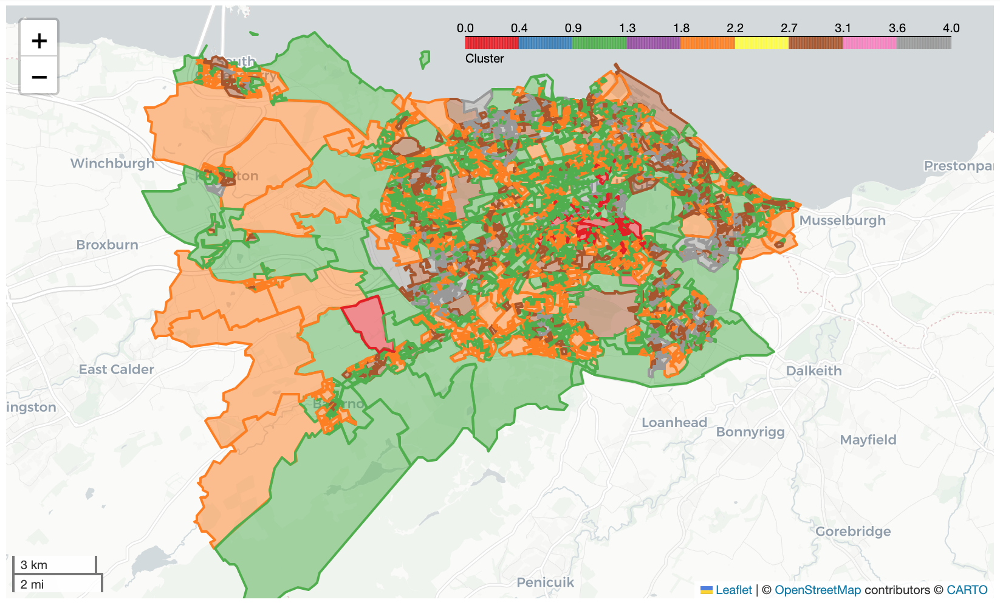